# Import

In [1]:
import os
import torch
from torch.utils.data import Dataset, DataLoader
from PIL import Image
from pathlib import Path
import torch.nn as nn
from torch.functional import F
import torchvision.transforms as T
from torchvision.utils import make_grid
import polars as pl
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
from tqdm.notebook import tqdm

# Data load

In [2]:
import kagglehub

# Download latest version
path = kagglehub.dataset_download("apollo2506/eurosat-dataset")

print("Path to dataset files:", path)

Path to dataset files: /home/mihalko711/.cache/kagglehub/datasets/apollo2506/eurosat-dataset/versions/6


In [3]:
img_path = os.path.join(path, "EuroSAT")

# Dataet

In [107]:
class EuroSATDataset(Dataset):
    def __init__(self, csv_path, image_root, return_label=False):
        self.df = pl.read_csv(csv_path).drop(pl.read_csv(csv_path).columns[0])
        self.image_root = Path(image_root)
        self.return_label = return_label

        self.transform = T.Compose([
            T.Resize((64, 64)),  # Гарантируем размер 64x64
            T.ToTensor(),        # Переводит [0, 255] -> [0.0, 1.0]
            T.Normalize(
                mean=[0.5, 0.5, 0.5], # (x - 0.5) / 0.5
                std=[0.5, 0.5, 0.5]   # Результат: [-1.0, 1.0]
            )
        ])

    def __len__(self):
        return self.df.height

    def __getitem__(self, idx):
        row = self.df.row(idx, named=True)

        img_path = self.image_root / row["Filename"]
        image = Image.open(img_path).convert("RGB")
        image = self.transform(image)

        if self.return_label:
            return image, row["Label"], row["ClassName"]

        return image

## how it look

torch.Size([3, 64, 64])


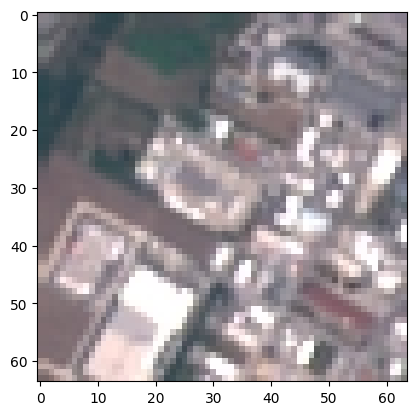

In [114]:
dataset = EuroSATDataset(
    csv_path=os.path.join(img_path, "train.csv"),
    image_root=os.path.join(img_path),
    return_label=True
)

idx = np.random.randint(len(dataset))

x, label, name = dataset[idx]
print(x.shape)
plt.imshow(x.permute(1, 2, 0) * 0.5 + 0.5)

## how it look batch edition

In [112]:
loader = DataLoader(dataset, batch_size=16)
iter_loader = iter(loader)

(np.float64(-0.5), np.float64(265.5), np.float64(265.5), np.float64(-0.5))

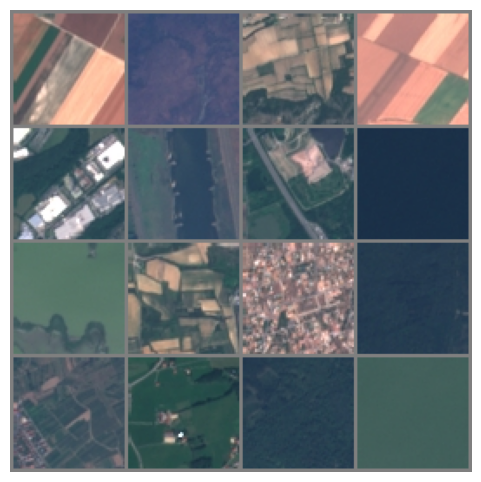

In [115]:
batch = next(iter_loader)[0]  # images
grid = make_grid(batch[:16], nrow=4)

plt.figure(figsize=(6,6))
plt.imshow(grid.permute(1,2,0) * 0.5 + 0.5)
plt.axis("off")

## how it looks by classes

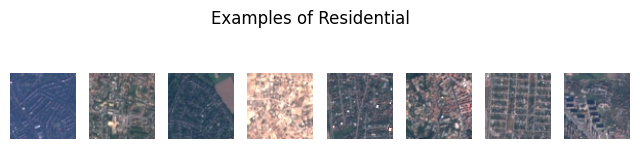

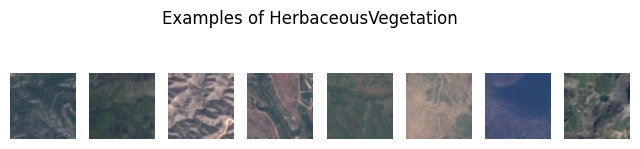

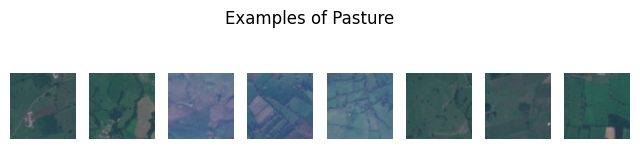

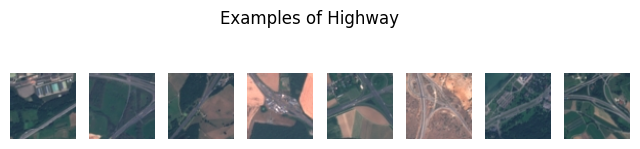

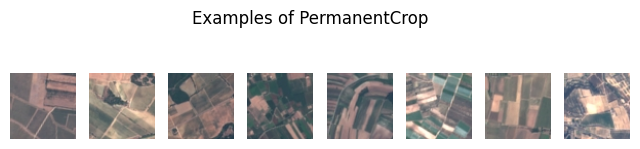

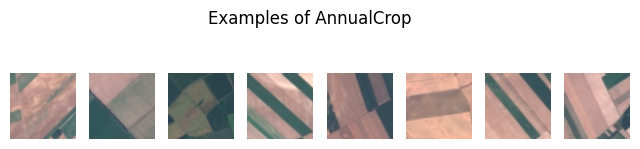

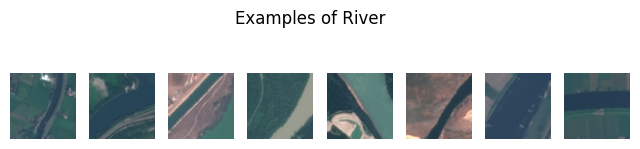

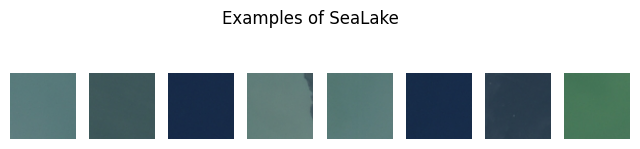

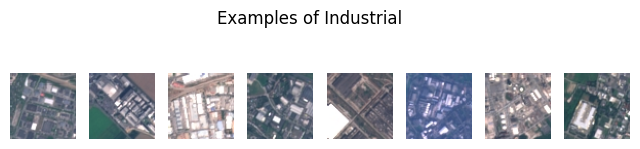

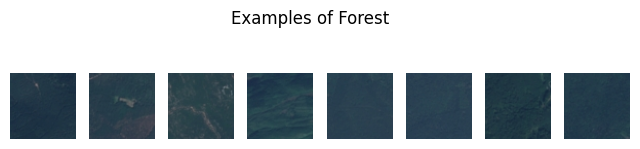

In [116]:
class_name = "AnnualCrop"
n = 8

def plot_n_rand_class(dataset, class_name, n):
    idxs = dataset.df \
        .with_columns(
            pl.arange(0, pl.len()).alias("idx")
        ) \
        .filter(
            pl.col("ClassName") == class_name
        ) \
        .select("idx").to_numpy().ravel()
    
    n_rand_idxs = np.random.choice(idxs, size=n)
    
    fig = plt.figure(figsize=(n, 2))
    fig.suptitle(f"Examples of {class_name}")
    for i, idx in enumerate(n_rand_idxs):
        x, label, class_name = dataset[idx]
        ax = fig.add_subplot(1, n, i + 1)
        ax.imshow(x.permute(1, 2, 0) * 0.5 + 0.5)
        ax.axis("off")


for class_name in dataset.df["ClassName"].unique():
    plot_n_rand_class(dataset, class_name, n)

# Firt VAE prototype

In [117]:
import torch
import torch.nn as nn
import torch.nn.functional as F

class ResidualBlock(nn.Module):
    """
    Базовый блок ResNet. Помогает избежать затухания градиента 
    и лучше передает текстурную информацию.
    """
    def __init__(self, in_channels, out_channels, stride=1):
        super().__init__()
        self.conv1 = nn.Conv2d(in_channels, out_channels, 3, stride=stride, padding=1, bias=False)
        self.bn1 = nn.GroupNorm(8, out_channels) # GroupNorm лучше BatchNorm для VAE (малые батчи)
        self.act1 = nn.SiLU() # Swish (SiLU) работает лучше ReLU в генеративных моделях
        
        self.conv2 = nn.Conv2d(out_channels, out_channels, 3, stride=1, padding=1, bias=False)
        self.bn2 = nn.GroupNorm(8, out_channels)
        self.act2 = nn.SiLU()

        self.shortcut = nn.Identity()
        if stride != 1 or in_channels != out_channels:
            self.shortcut = nn.Conv2d(in_channels, out_channels, 1, stride=stride, bias=False)

    def forward(self, x):
        residual = self.shortcut(x)
        out = self.act1(self.bn1(self.conv1(x)))
        out = self.bn2(self.conv2(out))
        out += residual
        return self.act2(out)

class TopoEncoder(nn.Module):
    def __init__(self, latent_dim=64):
        super().__init__()
        # Начинаем с меньшего числа каналов (16 или 32)
        self.initial = nn.Conv2d(3, 32, 4, stride=2, padding=1) # 64 -> 32
        self.act = nn.SiLU()
        
        self.net = nn.Sequential(
            # Было: 32->64->128->256->512
            # Стало: Меньше каналов, но та же глубина
            ResidualBlock(32, 64, stride=2),   # 32 -> 16
            ResidualBlock(64, 128, stride=2),  # 16 -> 8
            ResidualBlock(128, 256, stride=2), # 8 -> 4
            ResidualBlock(256, 256, stride=2), # 4 -> 2 (Max channels = 256)
        )
        
        self.pool = nn.AdaptiveAvgPool2d(1) 
        
        # Линейный слой теперь принимает 256, а не 512
        self.fc_mu = nn.Linear(256, latent_dim)
        self.fc_logvar = nn.Linear(256, latent_dim)

    def forward(self, x):
        x = self.act(self.initial(x))
        x = self.net(x)
        x = self.pool(x)
        x = x.flatten(1)
        return self.fc_mu(x), self.fc_logvar(x)

class TopoDecoder(nn.Module):
    def __init__(self, latent_dim=64, base_size=2):
        super().__init__()
        self.base_size = base_size 
        
        # Разворачиваем в 256 каналов (вместо 512)
        self.fc = nn.Linear(latent_dim, 256 * base_size * base_size)
        
        self.net = nn.Sequential(
            # Input: 256 x 2 x 2
            
            # -> 4x4
            nn.Upsample(scale_factor=2, mode='nearest'),
            ResidualBlock(256, 256), 
            
            # -> 8x8
            nn.Upsample(scale_factor=2, mode='nearest'),
            ResidualBlock(256, 128),
            
            # -> 16x16
            nn.Upsample(scale_factor=2, mode='nearest'),
            ResidualBlock(128, 64),
            
            # -> 32x32
            nn.Upsample(scale_factor=2, mode='nearest'),
            ResidualBlock(64, 32),

            # -> 64x64
            nn.Upsample(scale_factor=2, mode='nearest'),
            nn.Conv2d(32, 32, 3, padding=1), # Финальная обработка
            nn.SiLU(),
            nn.Conv2d(32, 3, 3, padding=1),
            
            nn.Tanh() 
        )

    def forward(self, z):
        h = self.fc(z)
        # Решейп под уменьшенное кол-во каналов
        h = h.view(-1, 256, self.base_size, self.base_size)
        return self.net(h)

class TopoGenVAE(nn.Module):
    def __init__(self, latent_dim=64):
        super().__init__()
        self.encoder = TopoEncoder(latent_dim)
        self.decoder = TopoDecoder(latent_dim, base_size=2) 

    def reparameterize(self, mu, logvar):
        std = torch.exp(0.5 * logvar)
        eps = torch.randn_like(std)
        return mu + eps * std

    def forward(self, x):
        mu, logvar = self.encoder(x)
        z = self.reparameterize(mu, logvar)
        x_hat = self.decoder(z)
        return x_hat, mu, logvar

In [118]:
class TopoGenLoss(nn.Module):
    def __init__(self):
        super().__init__()

    def forward(self, x, x_hat, mu, logvar, beta):
        """
        x: входные картинки (B, C, H, W)
        x_hat: восстановленные картинки (B, C, H, W)
        mu, logvar: параметры латентного распределения (B, latent_dim)
        beta: текущий вес KL-дивергенции (скаляр)
        """
        # 1. Reconstruction Loss (L1)
        # Используем sum по пикселям, затем делим на batch_size.
        # Это дает масштаб лосса ~1000-5000 для картинок 128x128
        recon_loss = F.l1_loss(x_hat, x, reduction='sum') / x.shape[0]

        # 2. KL Divergence
        # Аналитическая формула для N(mu, sigma) и N(0, 1)
        # Суммируем по измерениям латента, усредняем по батчу
        kld_loss = -0.5 * torch.sum(1 + logvar - mu.pow(2) - logvar.exp()) / x.shape[0]

        # Итоговый лосс
        total_loss = recon_loss + (beta * kld_loss)
        
        return total_loss, recon_loss, kld_loss

Starting training on cuda


  0%|          | 0/296 [00:00<?, ?it/s]

Epoch 1 Summary: Loss: 1784.0 | Recon: 1784.0 | KLD: 577.3 | Beta: 0.00000


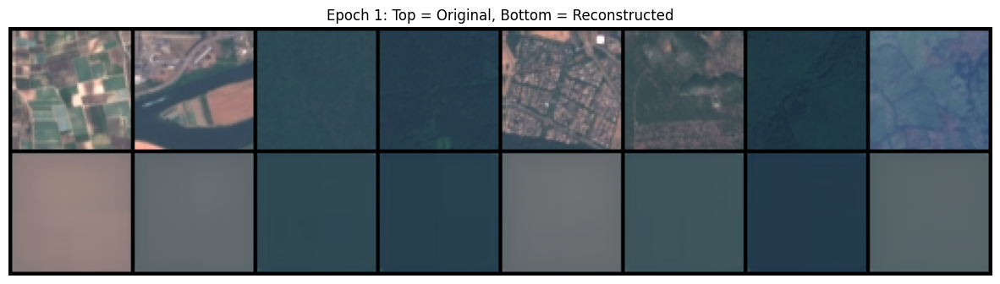

  0%|          | 0/296 [00:00<?, ?it/s]

Epoch 2 Summary: Loss: 1446.4 | Recon: 1446.4 | KLD: 643.3 | Beta: 0.00000


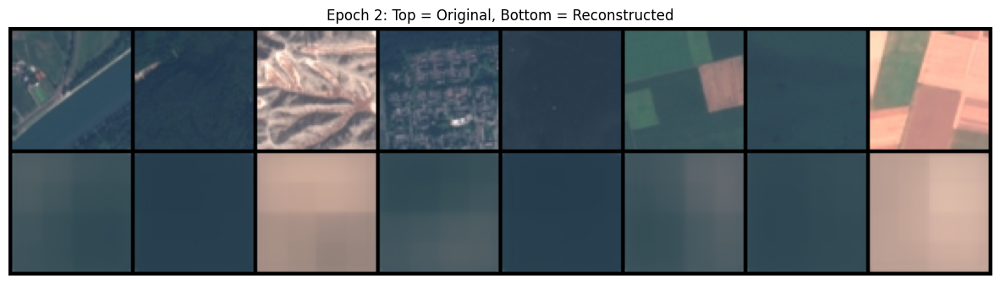

  0%|          | 0/296 [00:00<?, ?it/s]

Epoch 3 Summary: Loss: 1365.9 | Recon: 1365.9 | KLD: 524.6 | Beta: 0.00000


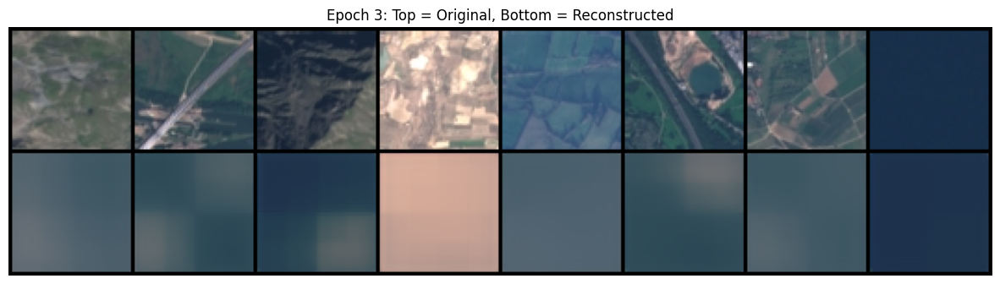

  0%|          | 0/296 [00:00<?, ?it/s]

Epoch 4 Summary: Loss: 1324.7 | Recon: 1324.7 | KLD: 552.5 | Beta: 0.00000


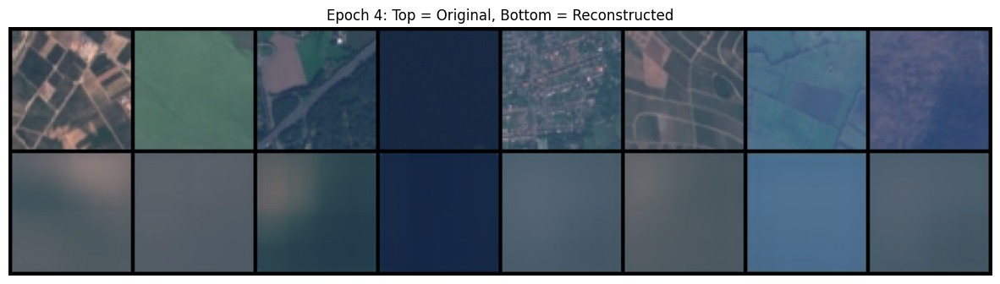

  0%|          | 0/296 [00:00<?, ?it/s]

Epoch 5 Summary: Loss: 1236.9 | Recon: 1236.9 | KLD: 465.4 | Beta: 0.00000


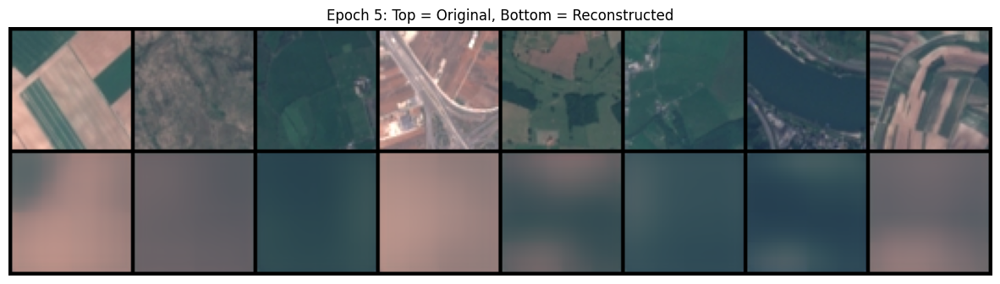

  0%|          | 0/296 [00:00<?, ?it/s]

Epoch 6 Summary: Loss: 1166.0 | Recon: 1166.0 | KLD: 475.1 | Beta: 0.00000


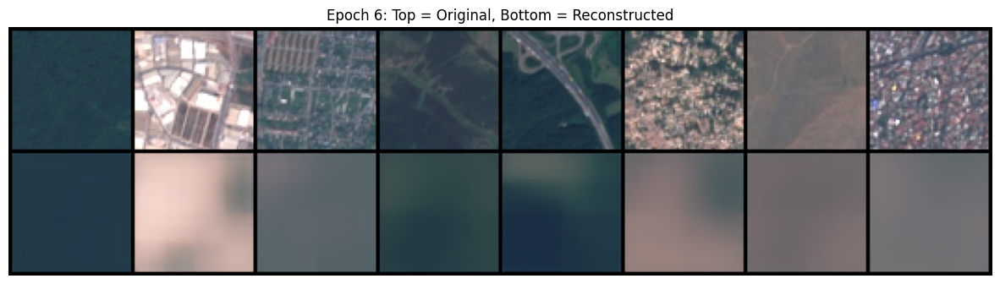

  0%|          | 0/296 [00:00<?, ?it/s]

Epoch 7 Summary: Loss: 1123.5 | Recon: 1123.4 | KLD: 483.4 | Beta: 0.00025


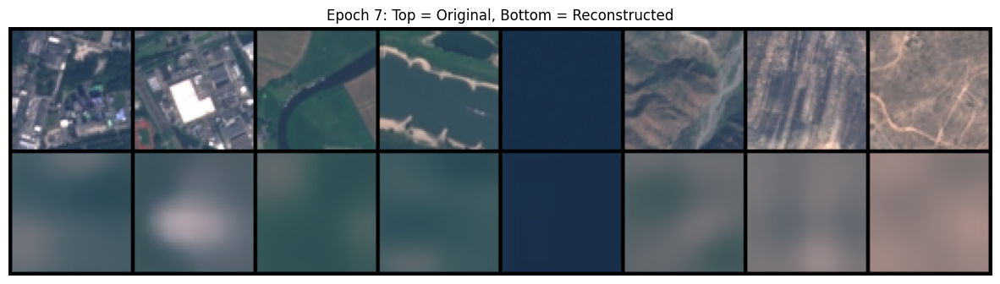

  0%|          | 0/296 [00:00<?, ?it/s]

Epoch 8 Summary: Loss: 1094.1 | Recon: 1093.9 | KLD: 483.9 | Beta: 0.00050


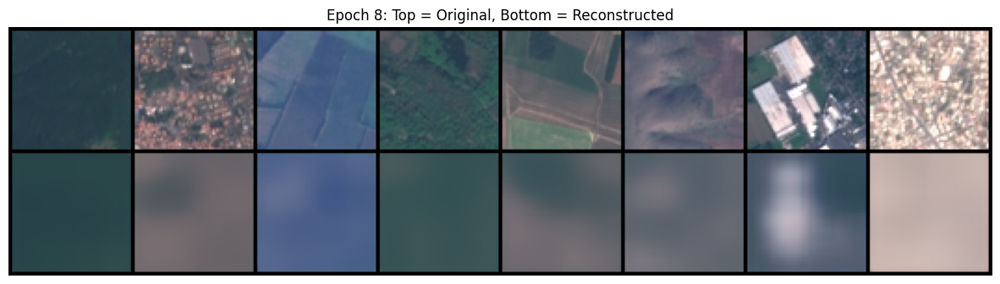

  0%|          | 0/296 [00:00<?, ?it/s]

Epoch 9 Summary: Loss: 1079.4 | Recon: 1079.1 | KLD: 486.4 | Beta: 0.00075


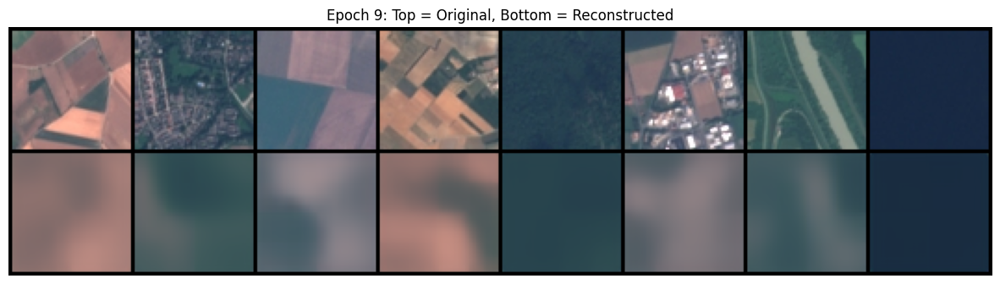

  0%|          | 0/296 [00:00<?, ?it/s]

Epoch 10 Summary: Loss: 1068.4 | Recon: 1068.0 | KLD: 465.6 | Beta: 0.00100


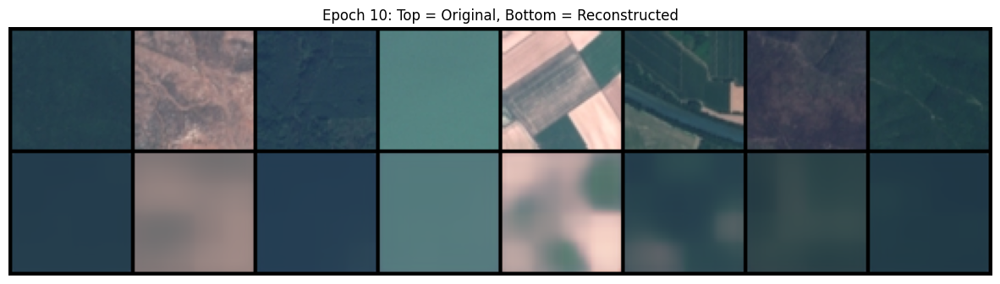

  0%|          | 0/296 [00:00<?, ?it/s]

Epoch 11 Summary: Loss: 1055.8 | Recon: 1055.2 | KLD: 439.4 | Beta: 0.00125


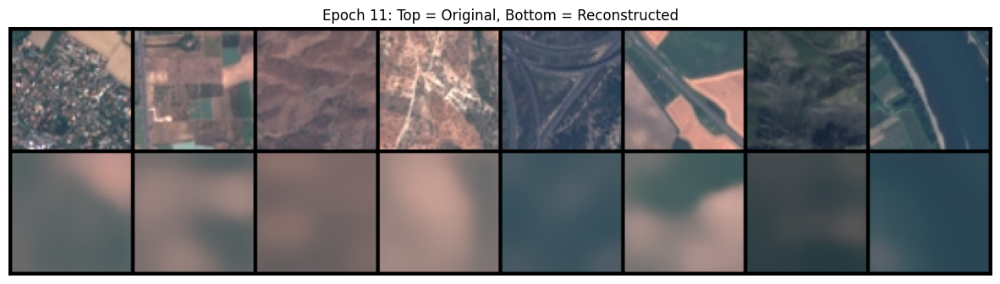

  0%|          | 0/296 [00:00<?, ?it/s]

Epoch 12 Summary: Loss: 1046.5 | Recon: 1045.8 | KLD: 420.4 | Beta: 0.00150


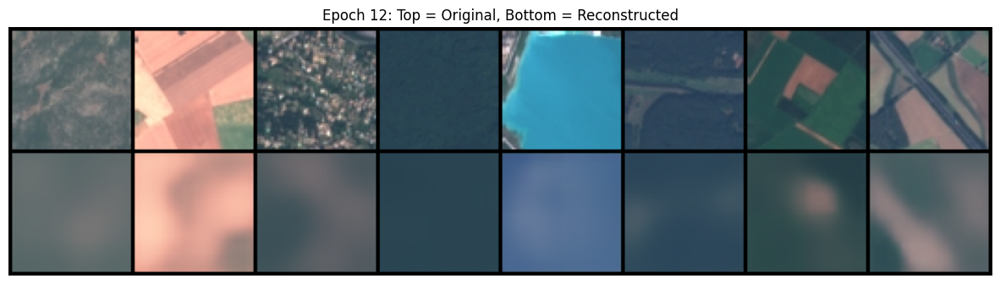

  0%|          | 0/296 [00:00<?, ?it/s]

Epoch 13 Summary: Loss: 1030.9 | Recon: 1030.2 | KLD: 399.0 | Beta: 0.00175


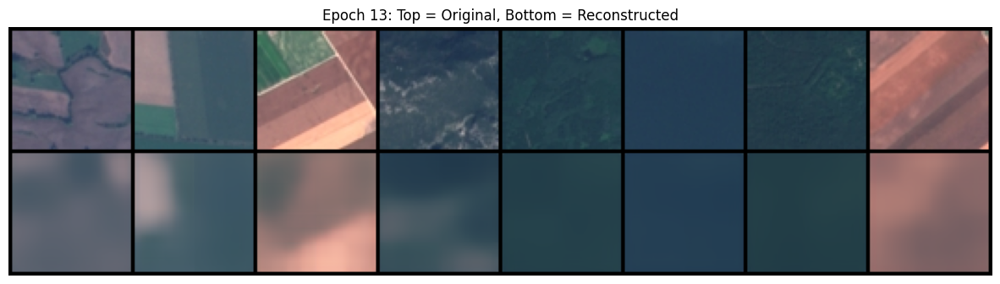

  0%|          | 0/296 [00:00<?, ?it/s]

Epoch 14 Summary: Loss: 1006.5 | Recon: 1005.7 | KLD: 372.7 | Beta: 0.00200


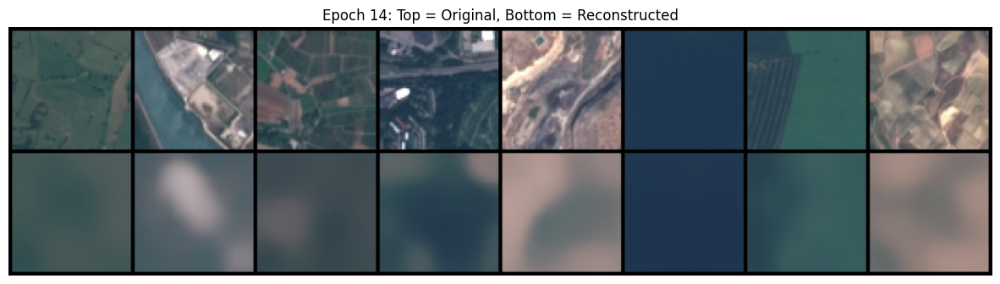

  0%|          | 0/296 [00:00<?, ?it/s]

Epoch 15 Summary: Loss: 999.4 | Recon: 998.6 | KLD: 364.0 | Beta: 0.00225


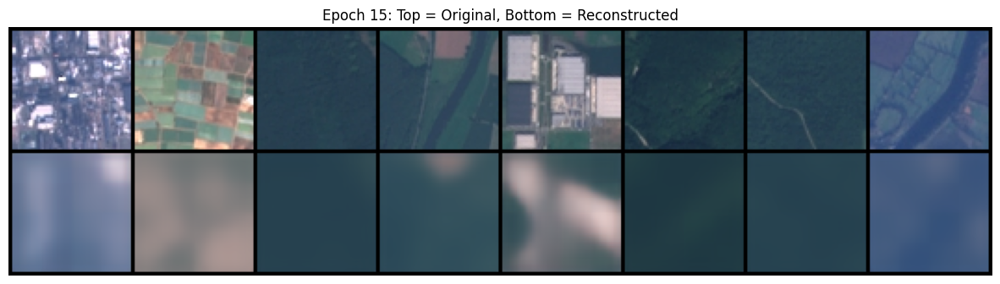

  0%|          | 0/296 [00:00<?, ?it/s]

Epoch 16 Summary: Loss: 982.2 | Recon: 981.3 | KLD: 356.4 | Beta: 0.00250


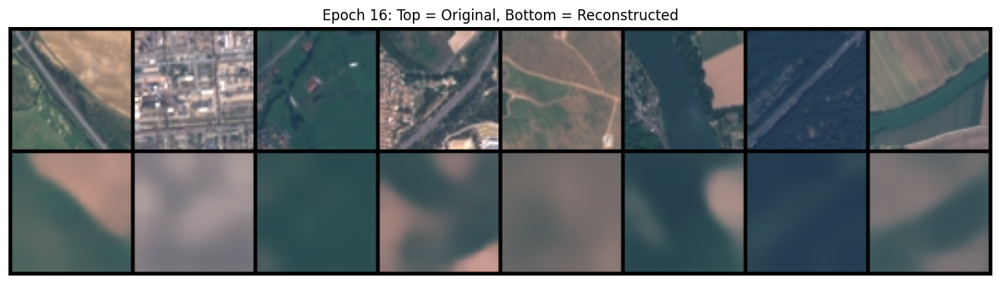

  0%|          | 0/296 [00:00<?, ?it/s]

Epoch 17 Summary: Loss: 970.1 | Recon: 969.2 | KLD: 347.1 | Beta: 0.00275


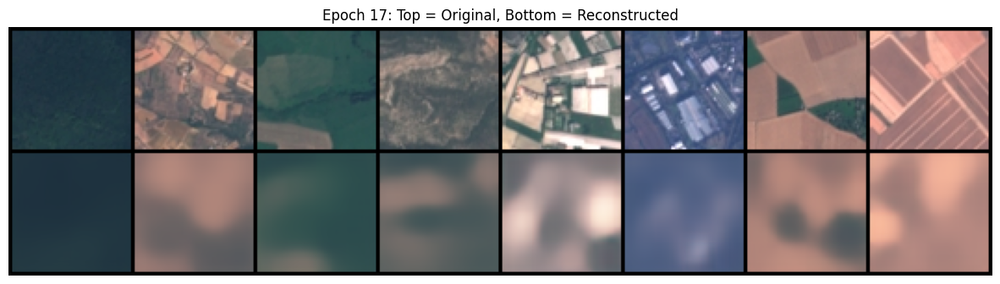

  0%|          | 0/296 [00:00<?, ?it/s]

Epoch 18 Summary: Loss: 961.7 | Recon: 960.6 | KLD: 343.5 | Beta: 0.00300


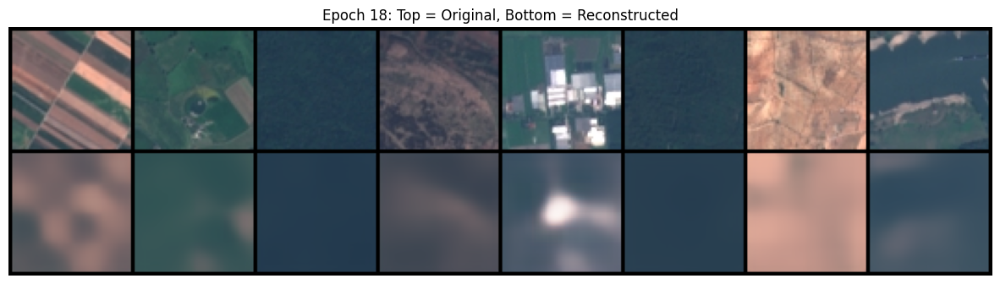

  0%|          | 0/296 [00:00<?, ?it/s]

Epoch 19 Summary: Loss: 948.9 | Recon: 947.8 | KLD: 330.4 | Beta: 0.00325


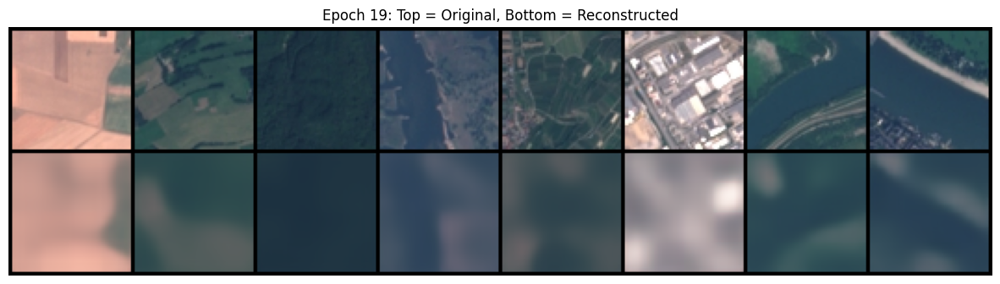

  0%|          | 0/296 [00:00<?, ?it/s]

Epoch 20 Summary: Loss: 939.0 | Recon: 937.9 | KLD: 321.3 | Beta: 0.00350


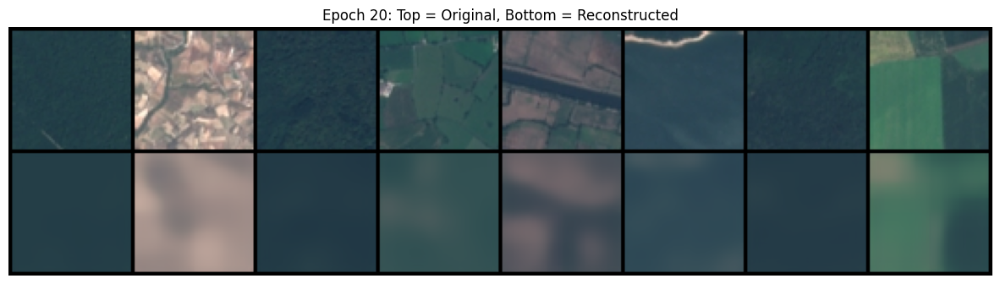

  0%|          | 0/296 [00:00<?, ?it/s]

Epoch 21 Summary: Loss: 932.4 | Recon: 931.2 | KLD: 319.3 | Beta: 0.00375


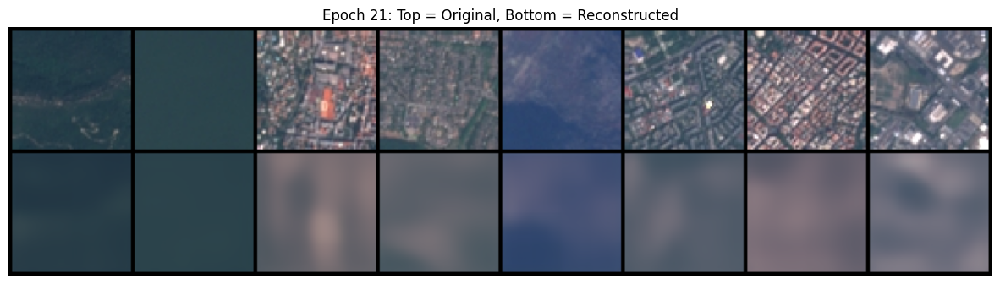

  0%|          | 0/296 [00:00<?, ?it/s]

Epoch 22 Summary: Loss: 927.5 | Recon: 926.2 | KLD: 314.7 | Beta: 0.00400


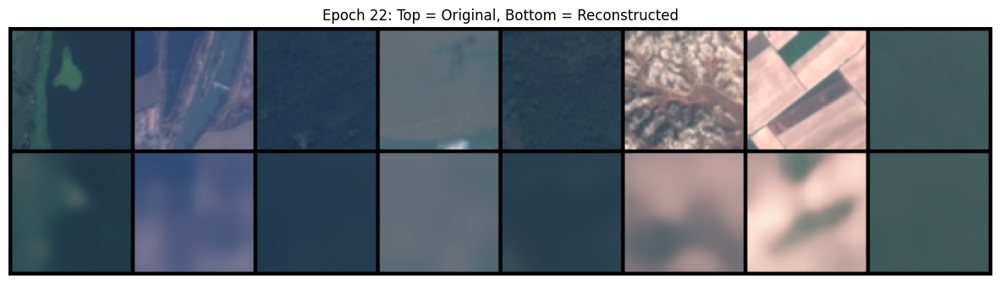

  0%|          | 0/296 [00:00<?, ?it/s]

Epoch 23 Summary: Loss: 921.3 | Recon: 920.0 | KLD: 309.3 | Beta: 0.00425


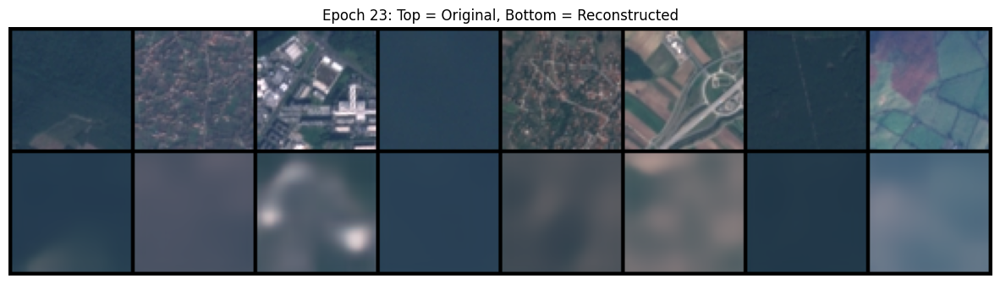

  0%|          | 0/296 [00:00<?, ?it/s]

Epoch 24 Summary: Loss: 917.0 | Recon: 915.6 | KLD: 303.4 | Beta: 0.00450


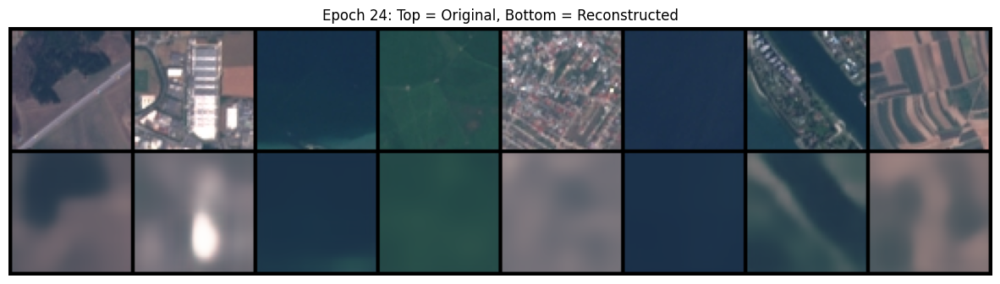

  0%|          | 0/296 [00:00<?, ?it/s]

Epoch 25 Summary: Loss: 915.3 | Recon: 913.9 | KLD: 301.1 | Beta: 0.00475


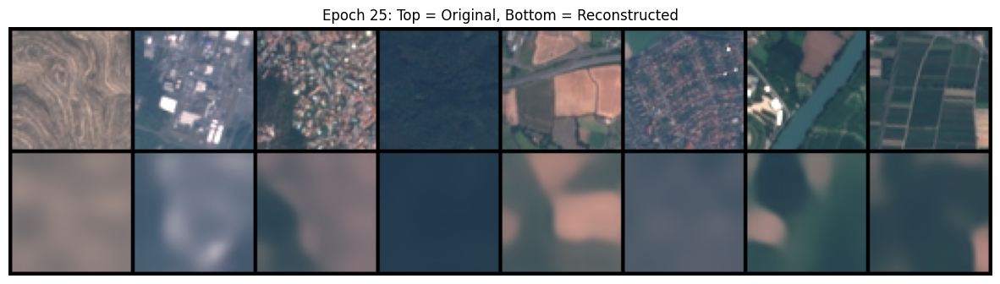

  0%|          | 0/296 [00:00<?, ?it/s]

Epoch 26 Summary: Loss: 907.0 | Recon: 905.5 | KLD: 298.1 | Beta: 0.00500


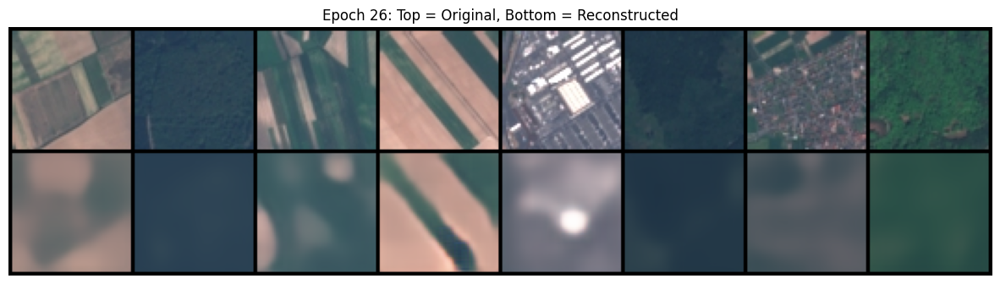

  0%|          | 0/296 [00:00<?, ?it/s]

Epoch 27 Summary: Loss: 897.7 | Recon: 896.3 | KLD: 295.7 | Beta: 0.00500


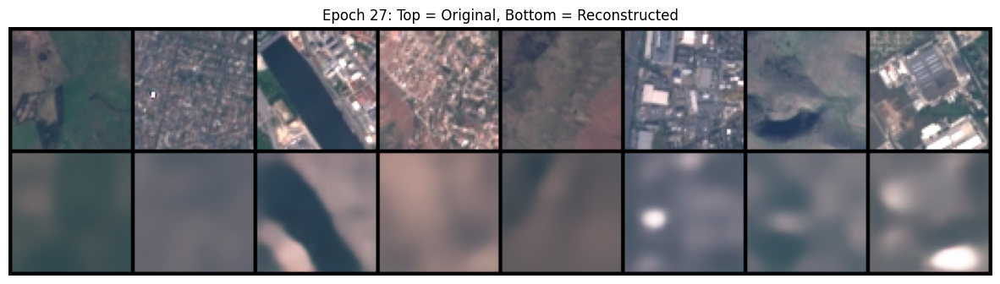

  0%|          | 0/296 [00:00<?, ?it/s]

Epoch 28 Summary: Loss: 893.6 | Recon: 892.1 | KLD: 295.5 | Beta: 0.00500


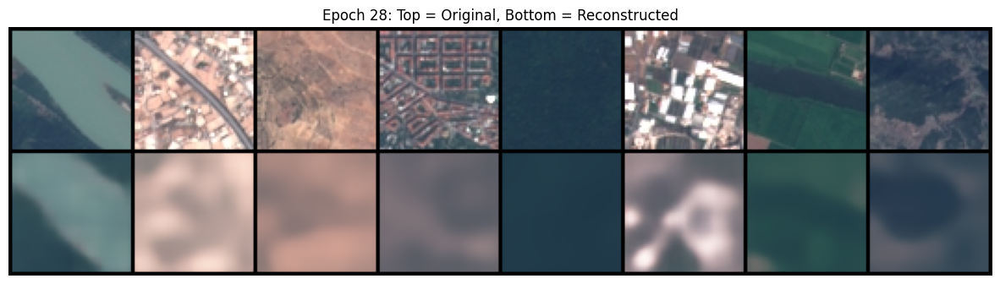

  0%|          | 0/296 [00:00<?, ?it/s]

Epoch 29 Summary: Loss: 881.1 | Recon: 879.6 | KLD: 295.4 | Beta: 0.00500


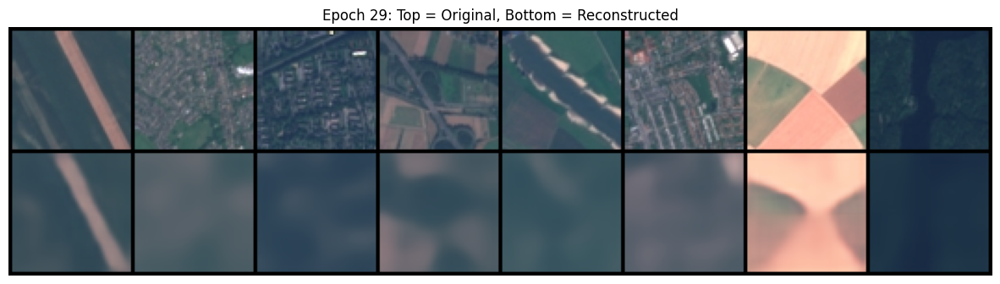

  0%|          | 0/296 [00:00<?, ?it/s]

Epoch 30 Summary: Loss: 878.5 | Recon: 877.0 | KLD: 296.3 | Beta: 0.00500


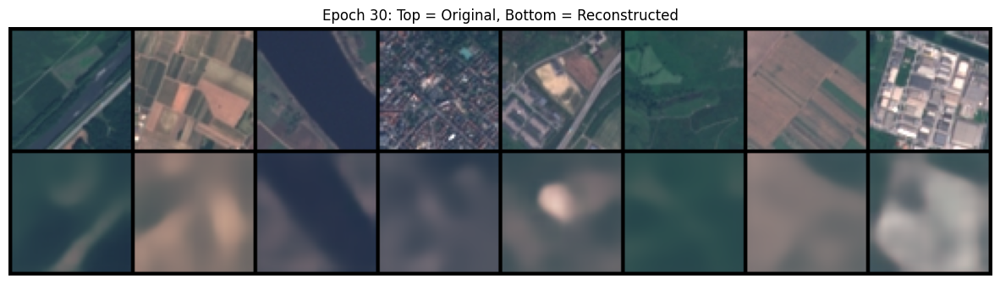

  0%|          | 0/296 [00:00<?, ?it/s]

Epoch 31 Summary: Loss: 874.6 | Recon: 873.1 | KLD: 295.3 | Beta: 0.00500


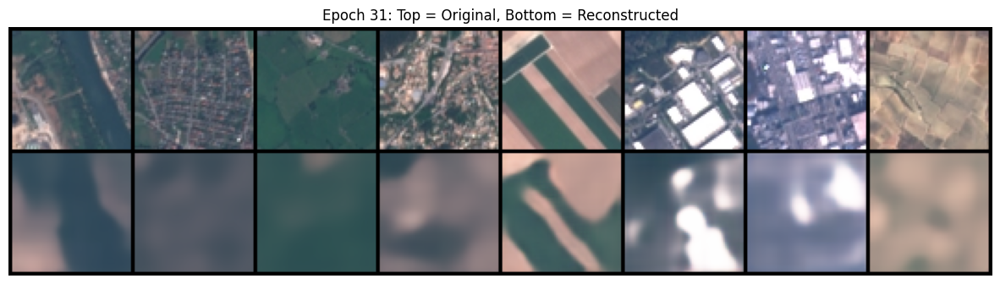

  0%|          | 0/296 [00:00<?, ?it/s]

Epoch 32 Summary: Loss: 871.6 | Recon: 870.2 | KLD: 291.7 | Beta: 0.00500


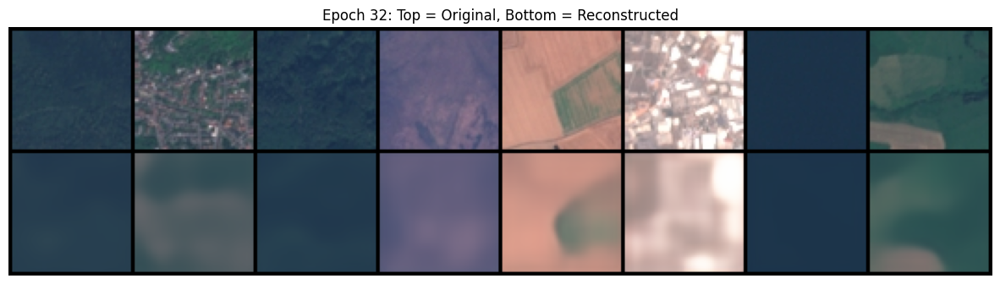

  0%|          | 0/296 [00:00<?, ?it/s]

Epoch 33 Summary: Loss: 864.9 | Recon: 863.5 | KLD: 293.3 | Beta: 0.00500


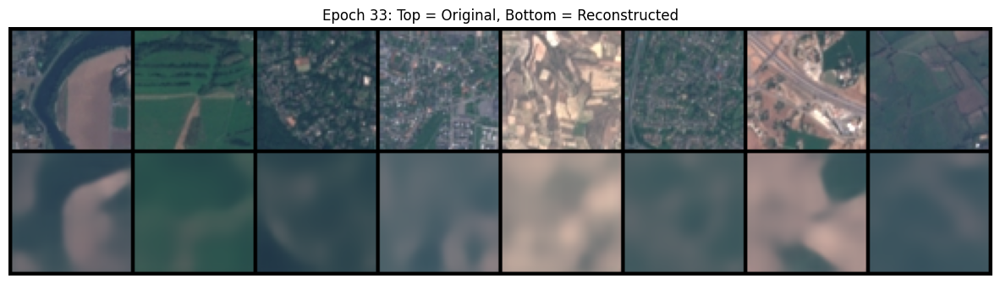

  0%|          | 0/296 [00:00<?, ?it/s]

Epoch 34 Summary: Loss: 859.1 | Recon: 857.7 | KLD: 292.7 | Beta: 0.00500


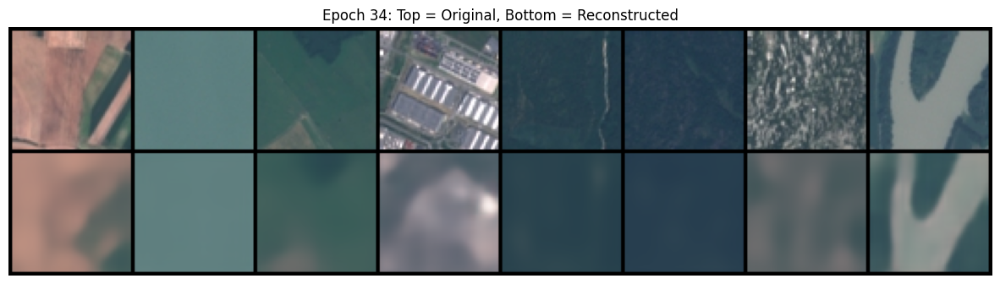

  0%|          | 0/296 [00:00<?, ?it/s]

Epoch 35 Summary: Loss: 857.2 | Recon: 855.7 | KLD: 293.4 | Beta: 0.00500


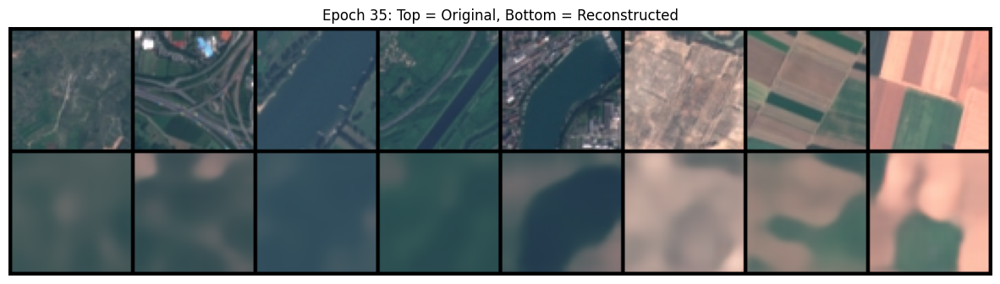

  0%|          | 0/296 [00:00<?, ?it/s]

Epoch 36 Summary: Loss: 853.3 | Recon: 851.9 | KLD: 291.3 | Beta: 0.00500


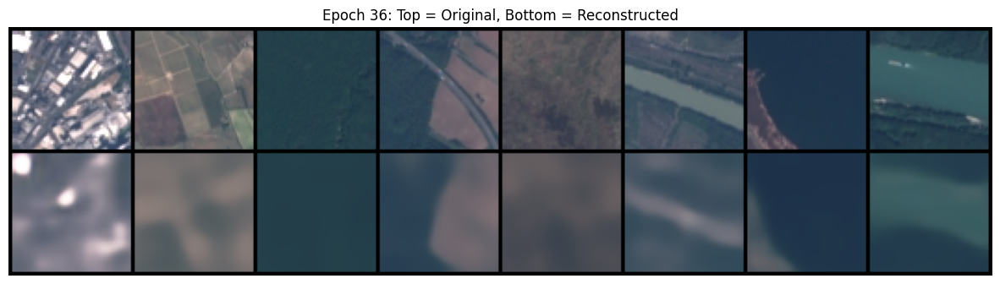

  0%|          | 0/296 [00:00<?, ?it/s]

Epoch 37 Summary: Loss: 846.1 | Recon: 844.6 | KLD: 291.0 | Beta: 0.00500


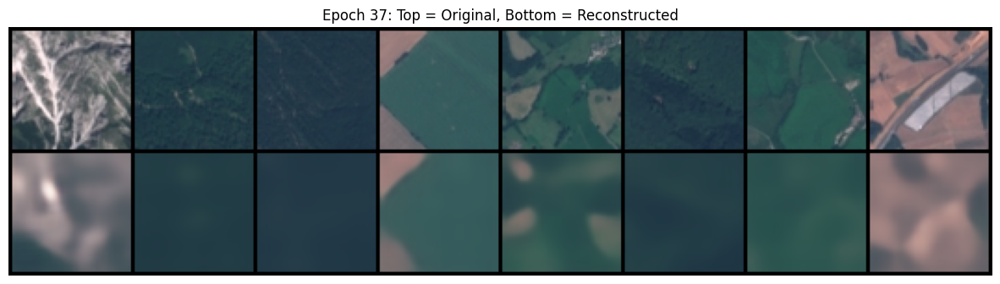

  0%|          | 0/296 [00:00<?, ?it/s]

Epoch 38 Summary: Loss: 841.9 | Recon: 840.4 | KLD: 291.9 | Beta: 0.00500


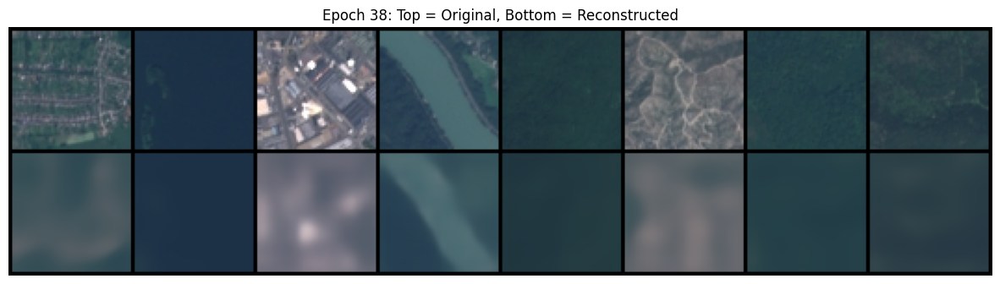

  0%|          | 0/296 [00:00<?, ?it/s]

Epoch 39 Summary: Loss: 839.7 | Recon: 838.2 | KLD: 291.9 | Beta: 0.00500


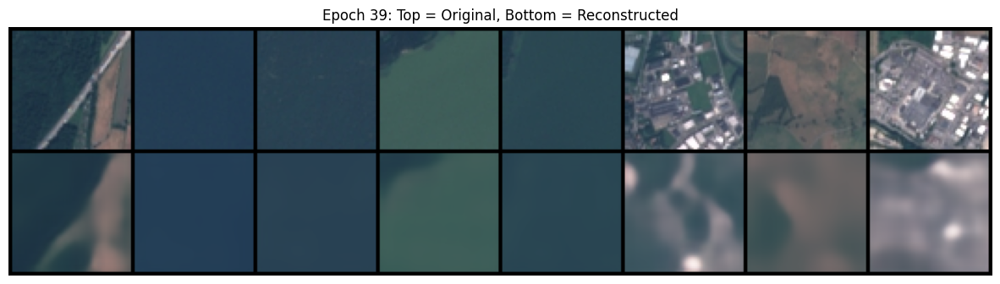

  0%|          | 0/296 [00:00<?, ?it/s]

Epoch 40 Summary: Loss: 836.2 | Recon: 834.7 | KLD: 291.2 | Beta: 0.00500


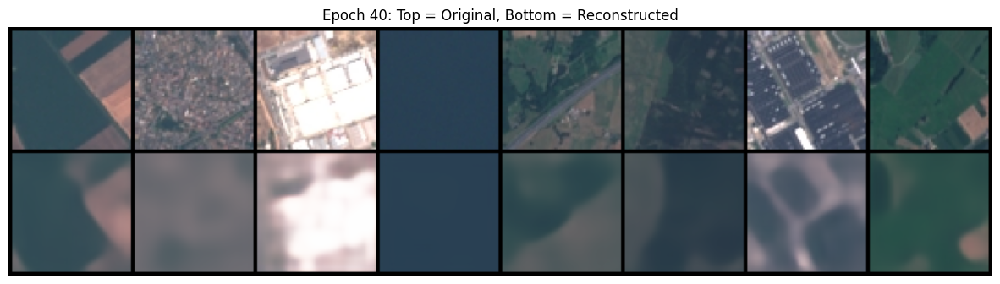

  0%|          | 0/296 [00:00<?, ?it/s]

Epoch 41 Summary: Loss: 830.7 | Recon: 829.3 | KLD: 291.0 | Beta: 0.00500


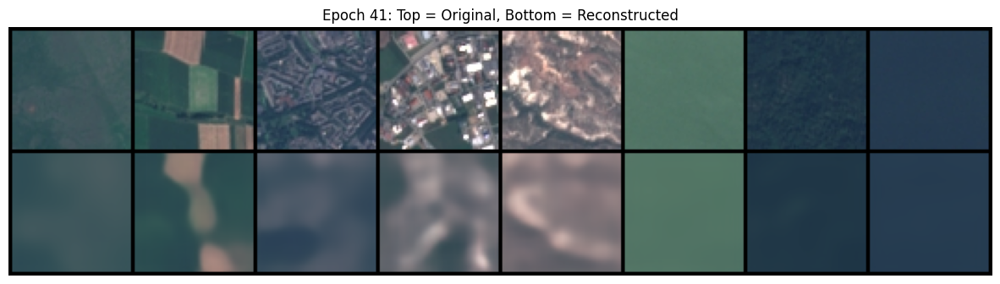

  0%|          | 0/296 [00:00<?, ?it/s]

Epoch 42 Summary: Loss: 825.9 | Recon: 824.5 | KLD: 293.2 | Beta: 0.00500


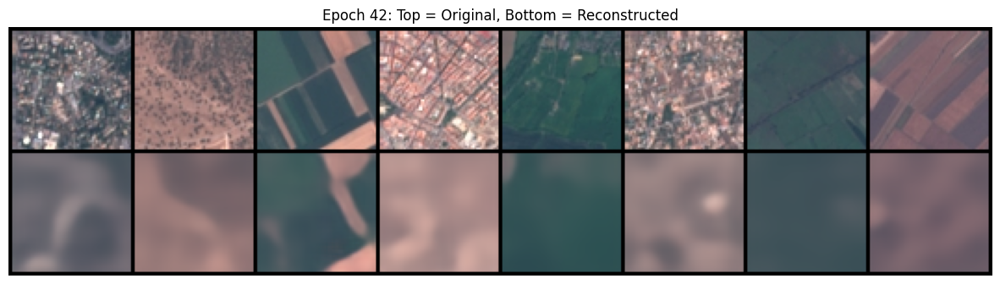

  0%|          | 0/296 [00:00<?, ?it/s]

Epoch 43 Summary: Loss: 820.1 | Recon: 818.6 | KLD: 294.0 | Beta: 0.00500


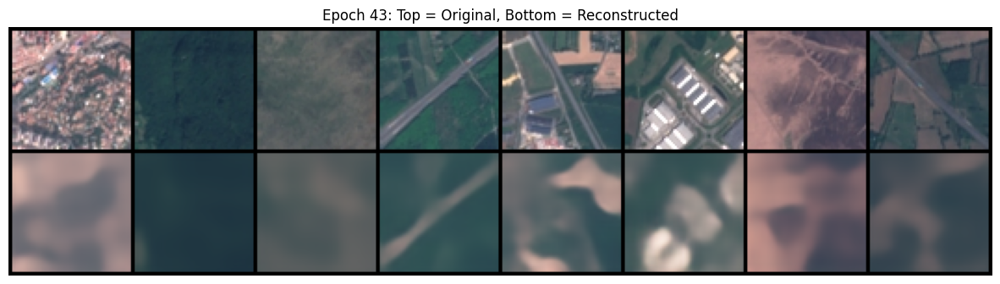

  0%|          | 0/296 [00:00<?, ?it/s]

Epoch 44 Summary: Loss: 817.3 | Recon: 815.9 | KLD: 292.7 | Beta: 0.00500


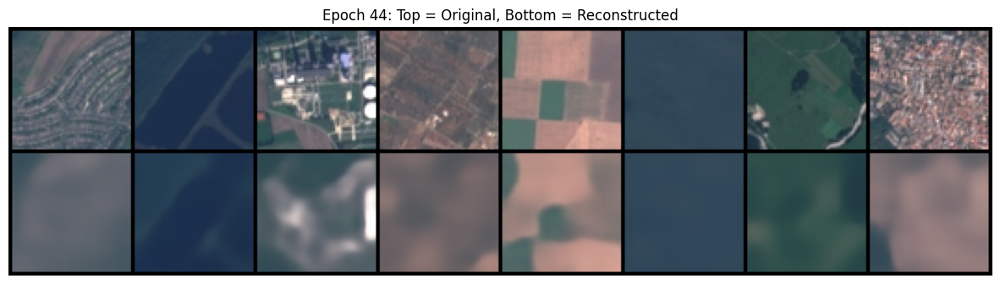

  0%|          | 0/296 [00:00<?, ?it/s]

Epoch 45 Summary: Loss: 813.8 | Recon: 812.4 | KLD: 292.1 | Beta: 0.00500


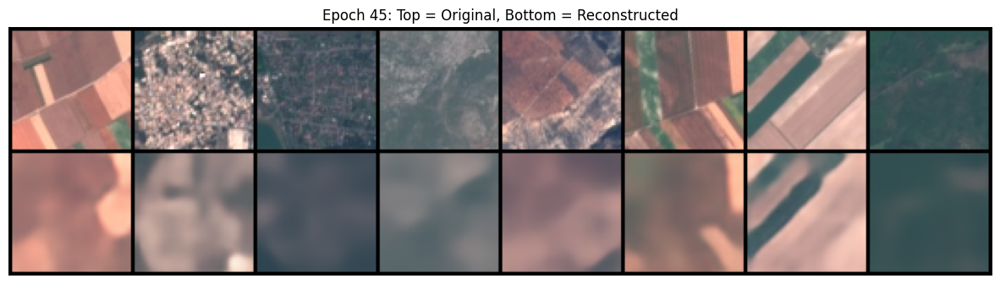

  0%|          | 0/296 [00:00<?, ?it/s]

Epoch 46 Summary: Loss: 806.8 | Recon: 805.4 | KLD: 291.8 | Beta: 0.00500


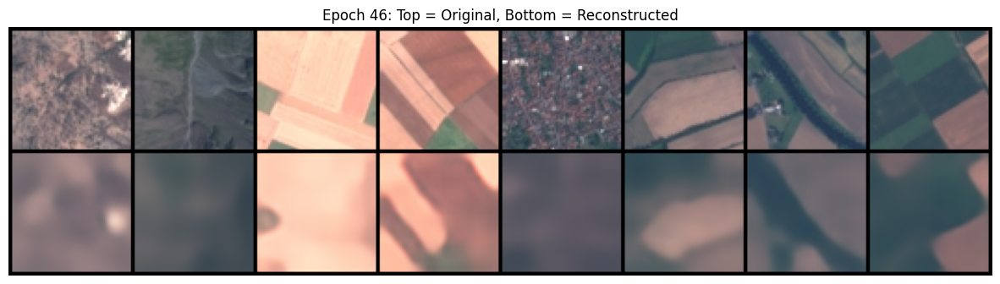

  0%|          | 0/296 [00:00<?, ?it/s]

Epoch 47 Summary: Loss: 802.0 | Recon: 800.5 | KLD: 292.2 | Beta: 0.00500


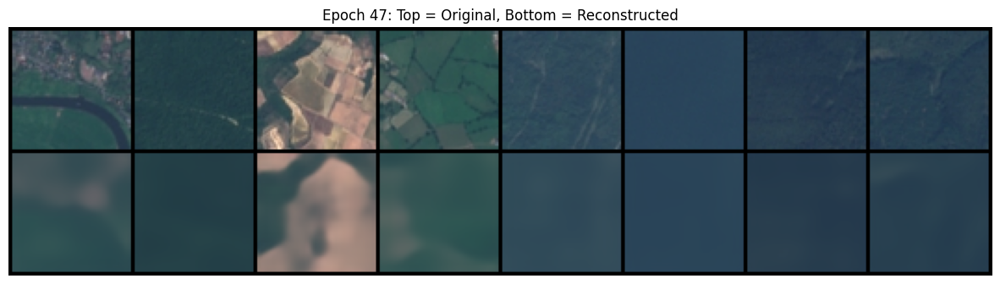

  0%|          | 0/296 [00:00<?, ?it/s]

Epoch 48 Summary: Loss: 799.4 | Recon: 797.9 | KLD: 294.4 | Beta: 0.00500


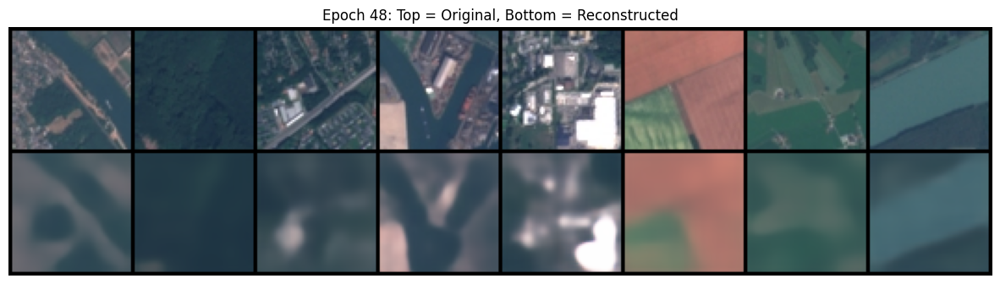

  0%|          | 0/296 [00:00<?, ?it/s]

Epoch 49 Summary: Loss: 797.5 | Recon: 796.0 | KLD: 293.1 | Beta: 0.00500


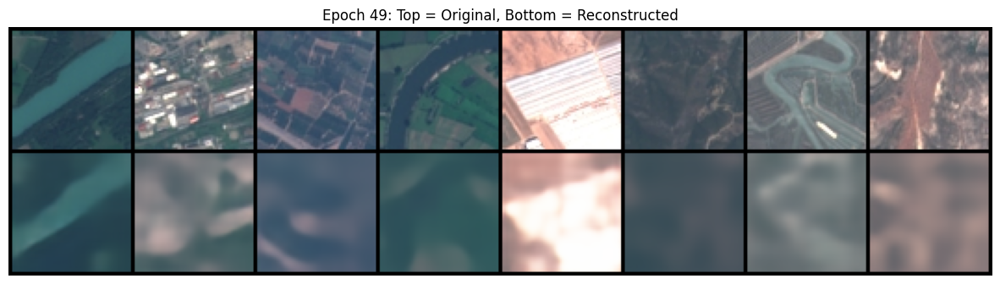

  0%|          | 0/296 [00:00<?, ?it/s]

Epoch 50 Summary: Loss: 791.9 | Recon: 790.4 | KLD: 293.2 | Beta: 0.00500


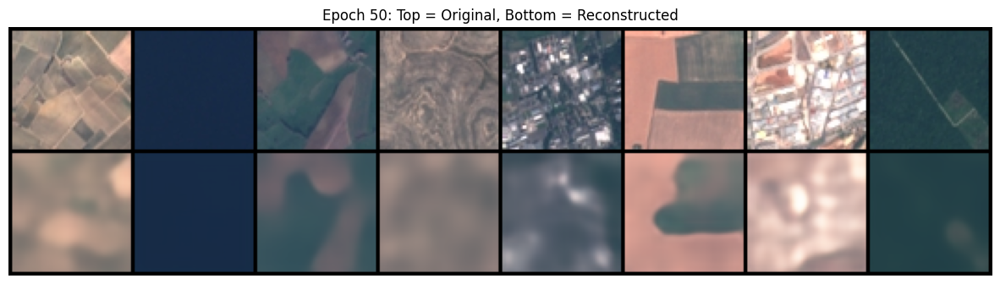

  0%|          | 0/296 [00:00<?, ?it/s]

Epoch 51 Summary: Loss: 787.6 | Recon: 786.1 | KLD: 291.6 | Beta: 0.00500


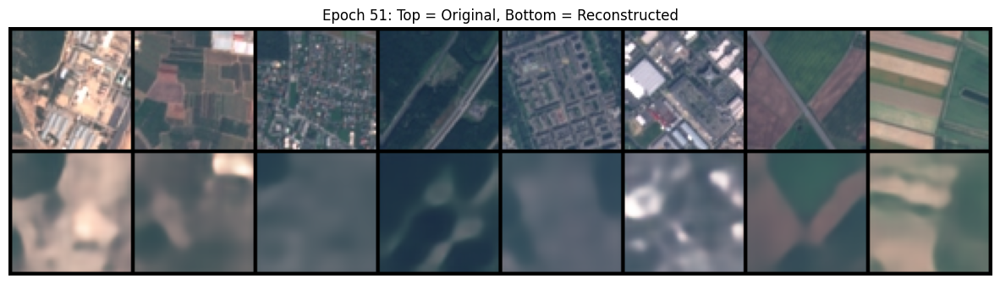

  0%|          | 0/296 [00:00<?, ?it/s]

Epoch 52 Summary: Loss: 784.5 | Recon: 783.0 | KLD: 293.2 | Beta: 0.00500


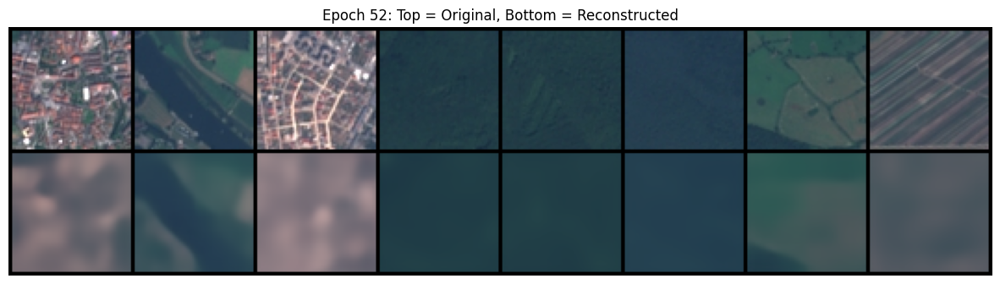

  0%|          | 0/296 [00:00<?, ?it/s]

Epoch 53 Summary: Loss: 782.5 | Recon: 781.0 | KLD: 293.3 | Beta: 0.00500


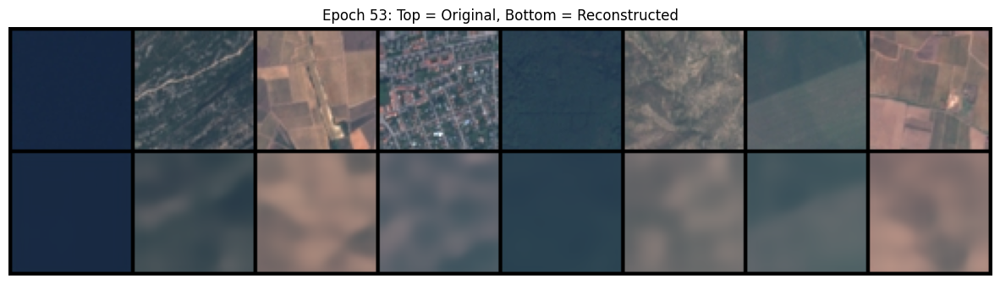

  0%|          | 0/296 [00:00<?, ?it/s]

Epoch 54 Summary: Loss: 778.3 | Recon: 776.8 | KLD: 294.6 | Beta: 0.00500


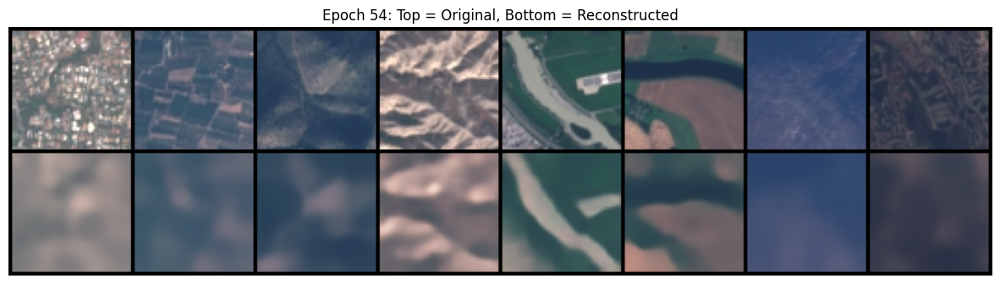

  0%|          | 0/296 [00:00<?, ?it/s]

Epoch 55 Summary: Loss: 776.6 | Recon: 775.1 | KLD: 291.6 | Beta: 0.00500


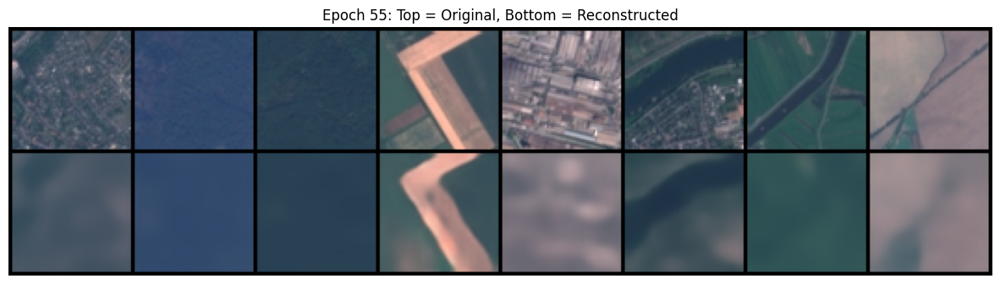

  0%|          | 0/296 [00:00<?, ?it/s]

KeyboardInterrupt: 

In [121]:
# --- Hyperparameters ---
LEARNING_RATE = 1e-3
EPOCHS = 100
LATENT_DIM = 64
MAX_BETA = 0.005      # Для L1 loss beta обычно маленькая (0.001 - 0.01)
WARMUP_EPOCHS = 5     # Сколько эпох beta = 0
ANNEAL_EPOCHS = 20    # За сколько эпох beta вырастет до MAX_BETA


dataset = EuroSATDataset(
    csv_path=os.path.join(img_path, "train.csv"),
    image_root=os.path.join(img_path),
    return_label=True
)

loader = DataLoader(dataset, batch_size=64, shuffle=True)
# --- Setup ---
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

# Инициализируем модель (из предыдущего ответа)
# Важно: img_size в VAE передавать не обязательно, так как у нас AdaptivePool, 
# но декодер настроен на base_size=4 (для 128x128).
model = TopoGenVAE(latent_dim=LATENT_DIM).to(device)

optimizer = torch.optim.AdamW(model.parameters(), lr=LEARNING_RATE, weight_decay=1e-5)
criterion = TopoGenLoss()

# --- Utility: Расчет beta ---
def get_beta(epoch, max_beta, warmup, anneal):
    if epoch < warmup:
        return 0.0
    elif epoch >= warmup + anneal:
        return max_beta
    else:
        # Линейный рост
        return max_beta * ((epoch - warmup) / anneal)

# --- Training Loop ---
print(f"Starting training on {device}")
history = {'loss': [], 'recon': [], 'kld': []}

for epoch in range(EPOCHS):
    model.train()
    train_loss = 0
    train_recon = 0
    train_kld = 0
    
    # Обновляем beta для текущей эпохи
    current_beta = get_beta(epoch, MAX_BETA, WARMUP_EPOCHS, ANNEAL_EPOCHS)
    
    loop = tqdm(loader, leave=False)
    for batch_idx, batch in enumerate(loop):
        
        # 2. Проверяем, что нам пришло
        if isinstance(batch, (tuple, list)):
            # Если dataset вернул (img, label, name), берем только img (индекс 0)
            img = batch[0]
        else:
            # Если dataset вернул только img (Тензор), то batch это и есть img
            img = batch

        img = img.to(device)
        
        # Дальше ваш код без изменений
        optimizer.zero_grad()
        x_hat, mu, logvar = model(img)
        loss, recon, kld = criterion(img, x_hat, mu, logvar, current_beta)
        
        # Backward
        optimizer.zero_grad()
        loss.backward()
        
        # Gradient Clipping (важно для стабилизации ResNet+VAE)
        torch.nn.utils.clip_grad_norm_(model.parameters(), max_norm=1.0)
        
        optimizer.step()
        
        # Stats
        train_loss += loss.item()
        train_recon += recon.item()
        train_kld += kld.item()
        
        # Обновляем прогресс бар
        loop.set_description(f"Epoch [{epoch+1}/{EPOCHS}]")
        loop.set_postfix(
            loss=loss.item(), 
            recon=recon.item(), 
            kld=kld.item(), 
            beta=current_beta
        )

    # Средние значения за эпоху
    avg_loss = train_loss / len(loader)
    avg_recon = train_recon / len(loader)
    avg_kld = train_kld / len(loader)
    
    history['loss'].append(avg_loss)
    
    print(f"Epoch {epoch+1} Summary: "
          f"Loss: {avg_loss:.1f} | "
          f"Recon: {avg_recon:.1f} | "
          f"KLD: {avg_kld:.1f} | "
          f"Beta: {current_beta:.5f}")

    # --- Визуализация (Обязательно!) ---
    # Сохраняем примеры раз в 5 эпох, чтобы видеть прогресс
    if (epoch + 1) % 1 == 0:
        model.eval()
        with torch.no_grad():
            # Достаем батч (учитываем возможную структуру кортежа)
            batch = next(iter(loader))
            sample_img = batch[0] if isinstance(batch, (list, tuple)) else batch
            sample_img = sample_img[:8].to(device) # Берем первые 8 штук
            
            recon_img, _, _ = model(sample_img)
            
            # Денормализация [-1, 1] -> [0, 1]
            sample_img = (sample_img * 0.5) + 0.5
            recon_img = (recon_img * 0.5) + 0.5
            
            # --- ВИЗУАЛИЗАЦИЯ ---
            
            # 1. Склеиваем: Оригиналы сверху, Реконструкции снизу
            # Получится тензор (16, C, H, W)
            comparison = torch.cat([sample_img, recon_img])
            
            # 2. Создаем сетку (grid)
            # nrow=8 означает, что в ряду будет 8 картинок. 
            # Так как у нас их 16, получится ровно 2 ряда (верхний - ориг, нижний - рекон)
            grid = make_grid(comparison, nrow=8, padding=2)
            
            grid_np = grid.cpu().permute(1, 2, 0).numpy()
            
            # 4. Рисуем
            plt.figure(figsize=(15, 5))
            plt.imshow(grid_np) 
            plt.axis('off') # Убираем оси координат
            plt.title(f"Epoch {epoch+1}: Top = Original, Bottom = Reconstructed")
            plt.show()